In [1]:
%%capture
# Clone repository
!git clone https://github.com/clement-bonnet/Lazimpa.git
!mv "./Lazimpa/egg" "./egg"
!mv "./Lazimpa/example" "./example"
!mv "./Lazimpa/experiments" "./experiments"
!mkdir "analysis"
!mkdir images_dir
!mkdir fig
!pip install images2gif
 
EXPERIMENTS_IMPATIENT = [
    "impatient", "impatient_nad_1e-2",
    "impatient_nad_1e-1", "impatient_nad_1"]
EXPERIMENTS_NOT_IMPATIENT = [
    "not_impatient", "not_impatient_nad_1e-2",
    "not_impatient_nad_1e-1", "not_impatient_nad_1"]
EXPERIMENTS = EXPERIMENTS_NOT_IMPATIENT + EXPERIMENTS_IMPATIENT
LABELS = {
    'impatient': ('impatient', '$\lambda_{NAD} = 0$'),
    'impatient_nad_1e-2': ('impatient', '$\lambda_{NAD} = 1e-2$'),
    'impatient_nad_1e-1': ('impatient', '$\lambda_{NAD} = 1e-1$'),
    'impatient_nad_1': ('impatient', '$\lambda_{NAD} = 1$'),
    'not_impatient': ('not impatient', '$\lambda_{NAD} = 0$'),
    'not_impatient_nad_1e-2': ('not impatient', '$\lambda_{NAD} = 1e-2$'),
    'not_impatient_nad_1e-1': ('not impatient', '$\lambda_{NAD} = 1e-1$'),
    'not_impatient_nad_1': ('not impatient', '$\lambda_{NAD} = 1$'),
}

In [133]:
# Useful functions (for analysis)

import os
import glob
import warnings
warnings.filterwarnings('ignore')
from PIL import Image as PILImage
from IPython.display import Image as IPythonImage
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from scipy.ndimage.filters import gaussian_filter1d


def load_message(expe):
    """
    Load messages stored during training procedure/
    Return numpy array with all the messages
    """
    np_load_old = np.load
    messages = np.load(expe,allow_pickle=True)
    np.load = np_load_old
    return messages

def img2gif(img_dir, output_file):
    """
    Transform a folder of images (img_dir) into a gif and save it with name output_file
    """
    # filepaths
    files = os.listdir(img_dir)
    files = [ _ for _ in files if ".png" in _ ]
    files = [int(_.split(".")[0]) for _ in files]
    files.sort()
    fp_in= [img_dir + f"/{_}.png" for _ in files]
    fp_out = output_file

    img, *imgs = [PILImage.open(f).resize((800,200)) for f in fp_in]
    img.save(fp=fp_out, format='GIF', append_images=imgs,
            save_all=True, duration=60, loop=0)

In [3]:
# Analysis
def test_channel(train_dir, analysis_dir):
    receiver_weights = os.path.join(train_dir, "receiver/receiver_weights100.pth")
    sender_weights = os.path.join(train_dir, "sender/sender_weights100.pth")
    # analysis_dir = os.path.join(analysis_dir)
    !python -m egg.zoo.channel.test --impatient=True --save_dir=$analysis_dir --receiver_weights=$receiver_weights --sender_weights=$sender_weights --vocab_size=40  --max_len=30 --n_features=100 --sender_cell="lstm" --receiver_cell="lstm" --sender_hidden=250 --receiver_hidden=600 --receiver_embedding=100 --sender_embedding=10 --sender_num_layers=1 --receiver_num_layers=1

def position_analysis(train_dir, analysis_dir):
    receiver_weights = os.path.join(train_dir, "receiver/receiver_weights100.pth")
    sender_weights = os.path.join(train_dir, "sender/sender_weights100.pth")
    # analysis_dir = os.path.join(analysis_dir)
    !python -m egg.zoo.channel.position_analysis --save_dir=$analysis_dir --impatient=True --sender_weights=$sender_weights --receiver_weights=$receiver_weights --vocab_size=40 --n_features=100 --max_len=30 --sender_cell="lstm" --receiver_cell="lstm" --sender_hidden=250 --receiver_hidden=600 --receiver_embedding=100 --sender_embedding=10 --sender_num_layers=1 --receiver_num_layers=1

def do_analysis(train_dir, analysis_dir):
    test_channel(train_dir, analysis_dir)
    position_analysis(train_dir, analysis_dir)

get_train_dir = lambda experiment: f"experiments/dir_save_{experiment}/"
get_analysis_dir = lambda experiment: f"analysis/{experiment}/"

def plot_all(plot_function, mode="train_dir"):
    for experiment in EXPERIMENTS:
        if mode == "train_dir":
            train_dir = get_train_dir(experiment)
            plot_function(train_dir)
        elif mode == "analysis_dir":
            analysis_dir = get_analysis_dir(experiment)
            plot_function(analysis_dir)
        else:
            raise ValueError(f"mode '{mode}' not in ['train_dir', 'analysis_dir']")

In [4]:
%%capture
# Do the analyses
for experiment in EXPERIMENTS:
    train_dir = get_train_dir(experiment)
    analysis_dir = get_analysis_dir(experiment)
    !mkdir $analysis_dir
    do_analysis(train_dir, analysis_dir)

### III-2. Analytical plots

**0. Number of consonant clusters:** Count number of consonant clusters of size 2 and 3 for each message

In [5]:
# def plot_consonant_clusters(train_dir):
#     # Choose epochs (between 0 and 500)
#     epochs=[1, 100, 300, 500]

#     for epoch in epochs:
#         # Load messages
#         message_path = os.path.join(train_dir, f"messages/messages_{epoch}.npy")
#         messages=load_message(message_path)

#         # Construct the length distribution
#         clstr2=[] #count number of clsuters of size 2
#         clstr3=[] #count number of clsuters of size 3
        
#         for message in messages:
#             ct2 = 0
#             ct3 = 0
#             for i in range(len(message)-2):
#                 # segment of size 2
#                 segment1 = message[i:i+2] 
#                 if (int(segment1[0]) < 27) and (int(segment1[1]) < 27):
#                     ct2 += 1
                
#                 # segment of size 3
#                 segment2 = message[i:i+3]
#                 if (int(segment2[0]) < 27) and (int(segment2[1]) < 27) and (int(segment2[2]) < 27):
#                     ct3 += 1

#             # side case of size 2
#             if len(message) > 1:
#                 if (int(message[-2]) < 27) and (int(message[-1]) < 27):
#                     ct2 += 1
            
#             clstr2.append(ct2)
#             clstr3.append(ct3)

#         # Add epoch to plot
#         plt.figure(1)
#         plt.plot(clstr2,label="Epoch "+str(epoch))

#         plt.figure(2)
#         plt.plot(clstr3,label="Epoch "+str(epoch))

#     # Plot fig
#     plt.figure(1)
#     plt.title("Number of consonant clusters of size 2 as a function of inputs ranked by frequency")
#     plt.xlabel("Inputs ranked by frequency")
#     plt.ylabel("clusters of size 2")
#     plt.xlim((0,100))
#     plt.ylim((0,32))
#     plt.legend()

#     plt.figure(2)
#     plt.title(f"Number of consonant clusters of size 3 as a function of inputs ranked by frequency - {train_dir}")
#     plt.xlabel("Inputs ranked by frequency")
#     plt.ylabel("clusters of size 3")
#     plt.xlim((0,100))
#     plt.ylim((0,32))
#     plt.legend()

#     plt.show()


In [6]:
# plot_all(plot_consonant_clusters)

# **Influence of lambda_nad**

<Figure size 720x504 with 0 Axes>

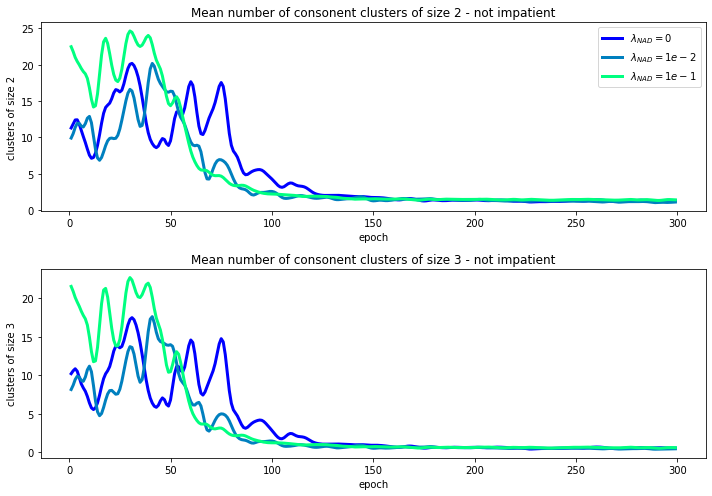

In [140]:
# Choose epochs (between 0 and 500)

EXPERIMENTS_nad = [
    "not_impatient", "not_impatient_nad_1e-2", "not_impatient_nad_1e-1"]

epochs=np.arange(1,300)

plt.figure(1, figsize=(10,7));
plt.figure(2, figsize=(10,7));

plt_cmap = plt.get_cmap('winter')(np.linspace(0,1,len(EXPERIMENTS_nad)))
for i_exp, exp in enumerate(EXPERIMENTS_nad):
  exp_type, label = LABELS[exp]
  mean_clstr2 = []
  mean_clstr3 = []
  for epoch in epochs:
    # Load messages
    path = "experiments/dir_save_"+exp+"/messages/messages_"+str(epoch)+".npy"
    messages=load_message(path)

    # Construct the length distribution
    clstr2=[] #count number of clsuters of size 2
    clstr3=[] #count number of clsuters of size 3
    
    for message in messages:
      ct2 = 0
      ct3 = 0
      for i in range(len(message)-2):
        # segment of size 2
        segment1 = message[i:i+2] 
        if (int(segment1[0]) < 27) and (int(segment1[1]) < 27):
          ct2 += 1
        
        # segment of size 3
        segment2 = message[i:i+3]
        if (int(segment2[0]) < 27) and (int(segment2[1]) < 27) and (int(segment2[2]) < 27):
          ct3 += 1

      # side case of size 2
      if len(message) > 1:
        if (int(message[-2]) < 27) and (int(message[-1]) < 27):
          ct2 += 1
      
      clstr2.append(ct2)
      clstr3.append(ct3)

    mean_clstr2.append(np.mean(np.array(clstr2)))
    mean_clstr3.append(np.mean(np.array(clstr3)))

  # Add epoch to plot
  plt.subplot(2, 1, 1)
  plt.plot(epochs, gaussian_filter1d(mean_clstr2, sigma=2),
           label=label, linewidth=3, c=plt_cmap[i_exp])

  plt.subplot(2, 1, 2)
  plt.plot(epochs, gaussian_filter1d(mean_clstr3, sigma=2),
           label=label, linewidth=3, c=plt_cmap[i_exp])

# Plot fig
plt.subplot(2, 1, 1)
plt.title(f"Mean number of consonent clusters of size 2 - {exp_type}")
plt.xlabel("epoch")
plt.ylabel("clusters of size 2")
plt.legend()

plt.subplot(2, 1, 2)
plt.title(f"Mean number of consonent clusters of size 3 - {exp_type}")
plt.xlabel("epoch")
plt.ylabel("clusters of size 3")

plt.tight_layout();
plt.savefig('fig/not_impatient_clusters.png', dpi=300);
plt.show();

<Figure size 720x504 with 0 Axes>

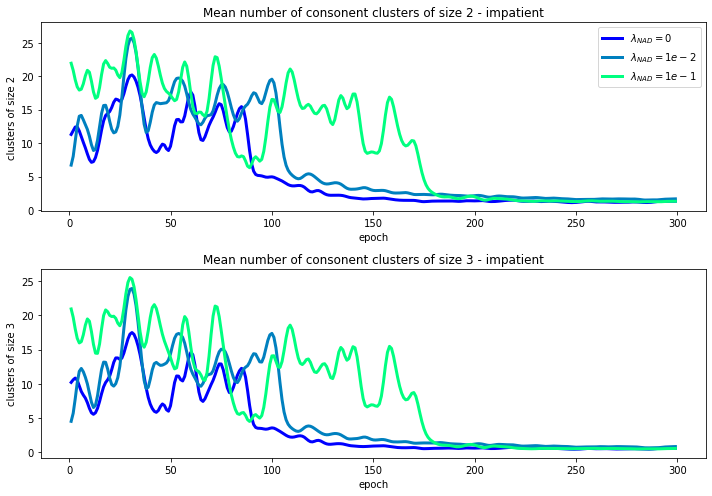

In [139]:
# Choose epochs (between 0 and 500)

EXPERIMENTS_nad_imp = [
    "impatient", "impatient_nad_1e-2", "impatient_nad_1e-1"]

epochs=np.arange(1,300)

plt.figure(1, figsize=(10,7));
plt.figure(2, figsize=(10,7));

plt_cmap = plt.get_cmap('winter')(np.linspace(0,1,len(EXPERIMENTS_nad_imp)))
for i_exp, exp in enumerate(EXPERIMENTS_nad_imp):
  exp_type, label = LABELS[exp]
  mean_clstr2 = []
  mean_clstr3 = []
  for epoch in epochs:
    # Load messages
    path = "experiments/dir_save_"+exp+"/messages/messages_"+str(epoch)+".npy"
    messages=load_message(path)

    # Construct the length distribution
    clstr2=[] #count number of clsuters of size 2
    clstr3=[] #count number of clsuters of size 3
    
    for message in messages:
      ct2 = 0
      ct3 = 0
      for i in range(len(message)-2):
        # segment of size 2
        segment1 = message[i:i+2] 
        if (int(segment1[0]) < 27) and (int(segment1[1]) < 27):
          ct2 += 1
        
        # segment of size 3
        segment2 = message[i:i+3]
        if (int(segment2[0]) < 27) and (int(segment2[1]) < 27) and (int(segment2[2]) < 27):
          ct3 += 1

      # side case of size 2
      if len(message) > 1:
        if (int(message[-2]) < 27) and (int(message[-1]) < 27):
          ct2 += 1
      
      clstr2.append(ct2)
      clstr3.append(ct3)

    mean_clstr2.append(np.mean(np.array(clstr2)))
    mean_clstr3.append(np.mean(np.array(clstr3)))

  # Add epoch to plot
  plt.subplot(2, 1, 1)
  plt.plot(epochs, gaussian_filter1d(mean_clstr2, sigma=2),
           label=label, linewidth=3, c=plt_cmap[i_exp])

  plt.subplot(2, 1, 2)
  plt.plot(epochs, gaussian_filter1d(mean_clstr3, sigma=2),
           label=label, linewidth=3, c=plt_cmap[i_exp])

# Plot fig
plt.subplot(2, 1, 1)
plt.title(f"Mean number of consonent clusters of size 2 - {exp_type}")
plt.xlabel("epoch")
plt.ylabel("clusters of size 2")
plt.legend()

plt.subplot(2, 1, 2)
plt.title(f"Mean number of consonent clusters of size 3 - {exp_type}")
plt.xlabel("epoch")
plt.ylabel("clusters of size 3")

plt.tight_layout();
plt.savefig('fig/impatient_clusters.png', dpi=300)
plt.show()

In [9]:
# plt.figure(1,figsize=(10,7))
# plt.figure(2,figsize=(10,7))

# for exp in EXPERIMENTS_nad:
#   mean_length_evolution=[]
#   for epoch in range(500):
#     # Load messages
#     path = "experiments/dir_save_"+exp+"/messages/messages_"+str(epoch)+".npy"
#     messages=load_message(path)

#     # Construct the length distribution
#     length_distribution=[]
#     for message in messages:
#       length_distribution.append(len(message))
    
#     # Get the mean length
#     mean_length_evolution.append(np.mean(length_distribution))

#   plt.figure(1)
#   plt.plot(mean_length_evolution,label=exp)

# for exp in EXPERIMENTS_nad_imp:
#   mean_length_evolution=[]
#   for epoch in range(500):
#     # Load messages
#     path = "experiments/dir_save_"+exp+"/messages/messages_"+str(epoch)+".npy"
#     messages=load_message(path)

#     # Construct the length distribution
#     length_distribution=[]
#     for message in messages:
#       length_distribution.append(len(message))
    
#     # Get the mean length
#     mean_length_evolution.append(np.mean(length_distribution))

#   plt.figure(2)
#   plt.plot(mean_length_evolution,label=exp)

# # Plot fig
# plt.figure(1)
# plt.title("Mean length evolution - not impatient")
# plt.xlabel("Training episodes")
# plt.ylabel("Mean length")
# plt.legend()

# plt.figure(2)
# plt.title("Mean length evolution - impatient")
# plt.xlabel("Training episodes")
# plt.ylabel("Mean length")
# plt.legend()

# plt.show()

In [10]:
# # Get accuracy
# plt.figure(1,figsize=(10,7))
# plt.figure(2,figsize=(10,7))
# for exp in EXPERIMENTS_nad:
#   accuracy=[]
#   for i in range(1,500):
#     path = "experiments/dir_save_"+exp+"/accuracy/accuracy_"+str(i)+".npy"
#     accuracy.append(np.mean(np.load(path)))
#   plt.figure(1)
#   plt.plot(accuracy,label=exp)

# for exp in EXPERIMENTS_nad_imp:
#   accuracy=[]
#   for i in range(1,500):
#     path = "experiments/dir_save_"+exp+"/accuracy/accuracy_"+str(i)+".npy"
#     accuracy.append(np.mean(np.load(path)))
#   plt.figure(2)
#   plt.plot(accuracy,label=exp)

# # Plot fig
# plt.figure(1)
# plt.title("Accuracy evolution - not impatient")
# plt.xlabel("Training episodes")
# plt.ylabel("Accuracy")
# plt.legend()

# plt.figure(2)
# plt.title("Accuracy evolution - impatient")
# plt.xlabel("Training episodes")
# plt.ylabel("Accuracy")
# plt.legend()

# plt.show()

**1. Length distribution for different epochs:** length distribution converges almost toward Optimal coding

In [11]:
# def plot_length_distribution(train_dir):
#     # Choose epochs (between 0 and 500)
#     epochs=[1, 100, 300, 500]

#     for epoch in epochs:
#         # Load messages
#         message_path = os.path.join(train_dir, f"messages/messages_{epoch}.npy")
#         messages=load_message(message_path)

#         # Construct the length distribution
#         length_distribution=[]
#         for message in messages:
#             length_distribution.append(len(message))

#         # Add epoch to plot
#         plt.plot(length_distribution,label="Epoch "+str(epoch))

#     # Plot fig
#     plt.title(f"Message length as a function of inputs ranked by frequency - {train_dir}")
#     plt.xlabel("Inputs ranked by frequency")
#     plt.ylabel("Message length")
#     plt.xlim((0,100))
#     plt.ylim((0,32))
#     plt.legend()
#     plt.show()


In [12]:
# plot_all(plot_length_distribution)

**2. Accuracy evolution**

In [13]:
# def plot_accuracy(train_dir, nb_epochs=500):
#     # Get accuracy
#     accuracy=[]
#     for i in range(1, nb_epochs+1):
#         accuracy_path = os.path.join(train_dir, "accuracy/accuracy_"+str(i)+".npy")
#         accuracy.append(np.mean(np.load(accuracy_path)))
#     # Plot fig
#     fig, ax = plt.subplots(1, 1, figsize=(11,4))
#     ax.plot(accuracy,label="LazImpa",c="tab:blue")
#     ax.set_title(f"Accuracy evolution - {train_dir}")
#     ax.set_xlabel("Training episodes")
#     ax.set_ylabel("Accuracy")
#     ax.set_xlim((0,nb_epochs))
#     ax.set_ylim((-0.05, 1.05))
#     plt.show()

In [14]:
# plot_all(plot_accuracy)

In [15]:
def plot_all_accuracy_same_plot(experiments, nb_epochs=500, save_name='fig.png', cmap='winter'):
    plt.figure(figsize=(11,4))
    nb_exp = len([exp for exp in experiments if exp.split('_')[-1] != '1'])
    plt_cmap = plt.get_cmap(cmap)(np.linspace(0,1,nb_exp))
    for i, experiment in enumerate(experiments):
        exp_type, label = LABELS[experiment]
        train_dir = get_train_dir(experiment)
        # Get accuracy
        accuracy=[]
        for epoch in range(nb_epochs):
            accuracy_path = os.path.join(train_dir, f"accuracy/accuracy_{epoch}.npy")
            accuracy.append(np.mean(np.load(accuracy_path)))
        # Plot fig
        if cmap != 'winter':
            label = exp_type
        if experiment.split('_')[-1] != '1': # do not plot lambda=1
            plt.plot(accuracy, label=label, c=plt_cmap[i], linewidth=2)
    plt.title(f"Accuracy evolution - {exp_type}" if cmap=='winter' else 'Accuracy evolution $(\lambda_{NAD} = 0)$')
    plt.xlabel("Training epochs")
    plt.ylabel("Accuracy")
    plt.xlim((0,nb_epochs))
    plt.ylim((-0.05, 1.05))
    leg = plt.legend()
    plt.savefig('fig/'+save_name, dpi=300)
    plt.show()

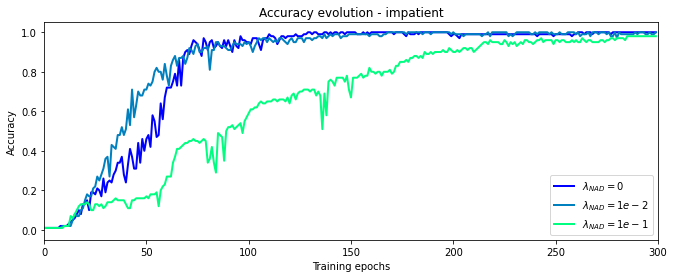

In [16]:
plot_all_accuracy_same_plot(EXPERIMENTS_IMPATIENT, nb_epochs=300, save_name='impatient_accuracy.png')

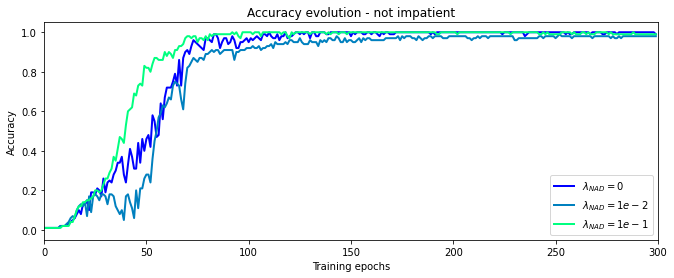

In [17]:
plot_all_accuracy_same_plot(EXPERIMENTS_NOT_IMPATIENT, nb_epochs=300, save_name='not_impatient_accuracy.png')

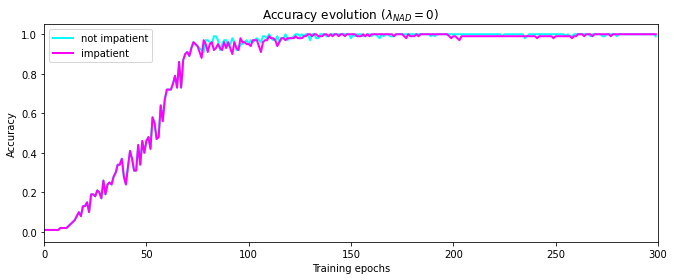

In [18]:
plot_all_accuracy_same_plot(['not_impatient', 'impatient'], nb_epochs=300, save_name='impatient_not_impatient_accuracy.png', cmap='cool')

**3. Mean length evolution**

In [19]:
# def plot_length_evolution(train_dir, nb_epochs=500):
#     mean_length_evolution=[]
#     for epoch in range(nb_epochs):
#         # Load messages
#         message_path = os.path.join(train_dir, f"messages/messages_{epoch}.npy")
#         messages=load_message(message_path)

#         # Construct the length distribution
#         length_distribution=[]
#         for message in messages:
#             length_distribution.append(len(message))
    
#         # Get the mean length
#         mean_length_evolution.append(np.mean(length_distribution))

#     # Plot fig
#     fig, ax = plt.subplots(1, 1, figsize=(11,4))
#     ax.plot(mean_length_evolution,label="LazImpa",c="tab:blue")
#     ax.set_title(f"Mean length evolution - {train_dir}")
#     ax.set_xlabel("Training epochs")
#     ax.set_ylabel("Mean length")
#     ax.set_xlim((0,nb_epochs))
#     ax.set_ylim((0,31))

#     plt.show()

In [20]:
# plot_all(plot_length_evolution)

In [21]:
def plot_all_length_evolution_same_plot(experiments, nb_epochs=500, save_name='fig.png', cmap='winter'):
    plt.figure(figsize=(11,4))
    nb_exp = len([exp for exp in experiments if exp.split('_')[-1] != '1'])
    plt_cmap = plt.get_cmap(cmap)(np.linspace(0,1,nb_exp))
    for i, experiment in enumerate(experiments):
        exp_type, label = LABELS[experiment]
        train_dir = get_train_dir(experiment)

        mean_length_evolution=[]
        for epoch in range(nb_epochs):
            # Load messages
            message_path = os.path.join(train_dir, f"messages/messages_{epoch}.npy")
            messages=load_message(message_path)

            # Construct the length distribution
            length_distribution=[]
            for message in messages:
                length_distribution.append(len(message))
        
            # Get the mean length
            mean_length_evolution.append(np.mean(length_distribution))

        # Plot fig
        if cmap != 'winter':
            label = exp_type
        if experiment.split('_')[-1] != '1': # do not plot lambda=1
            plt.plot(mean_length_evolution, label=label, c=plt_cmap[i], linewidth=2)
    plt.title(f"Mean length evolution - {exp_type}" if cmap=='winter' else 'Mean length evolution $(\lambda_{NAD} = 0)$')
    plt.xlabel("Training episodes")
    plt.ylabel("Mean length")
    plt.xlim((0,nb_epochs))
    plt.ylim((0,31))
    leg = plt.legend()
    plt.savefig('fig/'+save_name, dpi=300)
    plt.show()

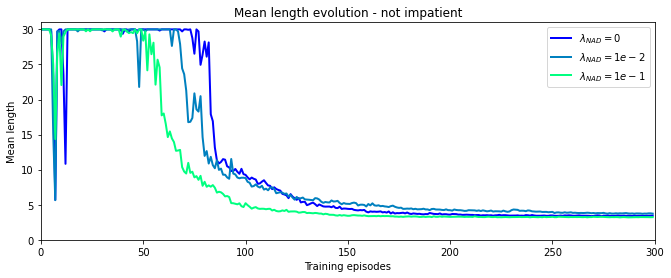

In [22]:
plot_all_length_evolution_same_plot(EXPERIMENTS_NOT_IMPATIENT, nb_epochs=300, save_name='not_impatient_length.png')

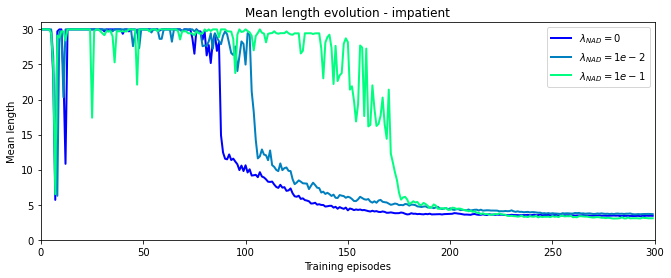

In [23]:
plot_all_length_evolution_same_plot(EXPERIMENTS_IMPATIENT, nb_epochs=300, save_name='impatient_length.png')

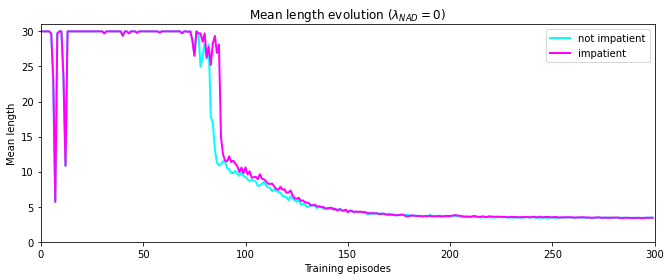

In [24]:
plot_all_length_evolution_same_plot(['not_impatient', 'impatient'], nb_epochs=300, save_name='impatient_not_impatient_length.png', cmap='cool')

**4. Accuracy = f(mean_length)**: co-evolution of the accuracy and mean message length: allow us to spot the beginning of the regularization (laziness)

In [25]:
# def plot_accuracy_message_length(train_dir, nb_epochs=500):
#     mean_length_evolution=[]
#     accuracy=[]

#     for epoch in range(nb_epochs):
#         # Load messages
#         message_path = os.path.join(train_dir, f"messages/messages_{epoch}.npy")
#         messages=load_message(message_path)

#         # Construct the length distribution
#         length_distribution=[]
#         for message in messages:
#             length_distribution.append(len(message))
        
#         # Get the mean length
#         mean_length_evolution.append(np.mean(length_distribution))

#         # Get the accuracy
#         accuracy_path = os.path.join(train_dir, "accuracy/accuracy_"+str(epoch)+".npy")
#         accuracy.append(np.mean(np.load(accuracy_path)))

#     # Plot fig
#     fig, ax = plt.subplots(1, 1, figsize=(7,7))
#     ax.scatter(mean_length_evolution,accuracy,s=2.5)
#     ax.set_title(f"Accuracy= f(mean message length) - {train_dir}")
#     ax.set_xlabel("Mean message length")
#     ax.set_ylabel("Accuracy")
#     ax.set_xlim((0,31))
#     ax.set_ylim((-0.05, 1.05))

#     plt.show()

In [26]:
# plot_all(plot_accuracy_message_length)

In [27]:
def plot_all_accuracy_message_length_same_plot(experiments, nb_epochs=500, save_name='fig.png', cmap='winter'):
    plt.figure(figsize=(7,7))
    nb_exp = len([exp for exp in experiments if exp.split('_')[-1] != '1'])
    plt_cmap = plt.get_cmap(cmap)(np.linspace(0,1,nb_exp))
    for i, experiment in enumerate(experiments):
        exp_type, label = LABELS[experiment]
        train_dir = get_train_dir(experiment)

        mean_length_evolution=[]
        accuracy=[]
        for epoch in range(nb_epochs):
            # Load messages
            message_path = os.path.join(train_dir, f"messages/messages_{epoch}.npy")
            messages=load_message(message_path)

            # Construct the length distribution
            length_distribution=[]
            for message in messages:
                length_distribution.append(len(message))
            
            # Get the mean length
            mean_length_evolution.append(np.mean(length_distribution))

            # Get the accuracy
            accuracy_path = os.path.join(train_dir, "accuracy/accuracy_"+str(epoch)+".npy")
            accuracy.append(np.mean(np.load(accuracy_path)))

        # Plot fig
        if cmap != 'winter':
            label = exp_type
        if experiment.split('_')[-1] != '1': # do not plot lambda=1
            plt.scatter(mean_length_evolution, accuracy, s=4, label=label, color=plt_cmap[i])
    plt.title(f"Accuracy = f(mean message length), {exp_type}" if cmap=='winter' else 'Accuracy = f(mean message length), $\lambda_{NAD} = 0$')
    plt.xlabel("Mean message length")
    plt.ylabel("Accuracy")
    plt.xlim((0,31))
    plt.ylim((-0.05, 1.05))
    leg = plt.legend()
    plt.savefig('fig/'+save_name, dpi=300)
    plt.show()

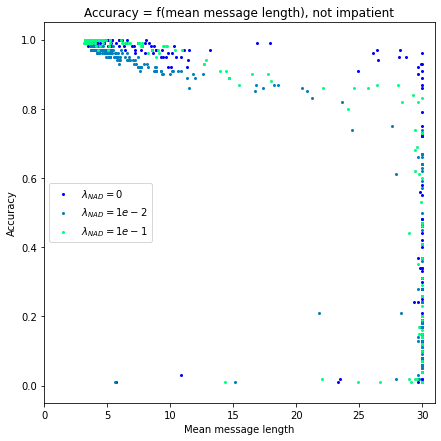

In [28]:
plot_all_accuracy_message_length_same_plot(EXPERIMENTS_NOT_IMPATIENT, nb_epochs=300, save_name='not_impatient_accuracy_message_length.png')

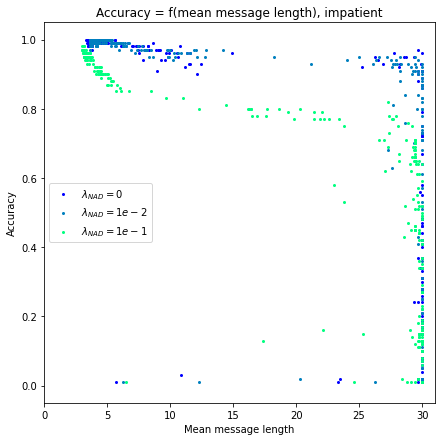

In [29]:
plot_all_accuracy_message_length_same_plot(EXPERIMENTS_IMPATIENT, nb_epochs=300, save_name='impatient_accuracy_message_length.png')

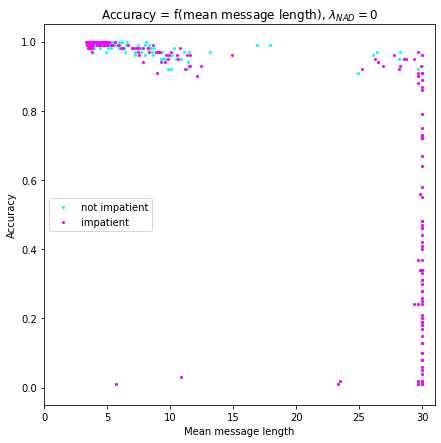

In [30]:
plot_all_accuracy_message_length_same_plot(['not_impatient', 'impatient'], nb_epochs=300, save_name='impatient_not_impatient_accuracy_message_length.png', cmap='cool')

**5. Position of informative symbols**: allows us to see where informative symbols are set within the messages

legend:
- yellow: uninformative ; 1: informative; purple: no symbol
- 1: uninformative ; 0: informative ; -1 no symbol

In [31]:
# def plot_informative_symbols(analysis_dir):
#     # Color the matrix of "information test"
#     analysis_path = os.path.join(analysis_dir, "position_sieve.npy")
#     plt.matshow(np.load(analysis_path))
#     plt.xlabel("Position")
#     plt.ylabel("Message (ranked by frequency)")
#     plt.title(f"Position of informative symbols - {analysis_dir}")
#     plt.show()

In [32]:
# plot_all(plot_informative_symbols, mode="analysis_dir")

**6. Dynamic evolution of the training**: (takes a few minutes to run)

Create gif

In [33]:
# def create_gif(train_dir, nb_epochs=500, plot_every=10):
#     # Create gif
#     experiment = '_'.join(train_dir.split('/')[1].split('_')[2:])
#     image_dir = os.path.join("images_dir", experiment)
#     !mkdir $image_dir

#     accuracy_lazimpa=[]
#     mean_len_lazimpa=[]
#     accuracy_normal=[]
#     mean_len_normal=[]
#     accuracy_impatient=[]
#     mean_len_impatient=[]
#     accuracy_normreg=[]
#     mean_len_normreg=[]

#     range_ = range(plot_every, nb_epochs+1, plot_every)
#     for index, i in enumerate(range_):
#         message_path = os.path.join(train_dir, f"messages/messages_{i}.npy")
#         messages_lazimpa = load_message(message_path)

#         L_lazimpa=[]

#         for m in messages_lazimpa:
#             L_lazimpa.append(len(m))
        
#         mean_len_lazimpa.append(np.mean(L_lazimpa))
#         accuracy_path = os.path.join(train_dir, "accuracy/accuracy_"+str(i)+".npy")
#         accuracy_lazimpa.append(np.mean(np.load(accuracy_path)))

#         fig, axs = plt.subplots(1, 3, figsize=(11,4))
#         axs[0].plot(L_lazimpa, label="LazImpa", c="tab:blue")
#         axs[0].set_ylim((0,32))
#         axs[0].set_xlabel("Input ranked by frequency")
#         axs[0].set_ylabel("Message length") 
#         axs[0].set_title(f"Length distribution {experiment}") 

#         axs[1].plot(range_[:index+1], accuracy_lazimpa, label="LazImpa", c="tab:blue")
#         axs[1].set_xlabel("Training episodes")
#         axs[1].set_ylabel("Accuracy")
#         axs[1].set_title(f"Accuracy evolution {experiment}")
#         axs[1].set_xlim((0,nb_epochs))
#         axs[1].set_ylim((-0.05, 1.05))

#         axs[2].plot(range_[:index+1], mean_len_lazimpa,label="LazImpa",c="tab:blue")
#         axs[2].set_xlabel("Training episodes")
#         axs[2].set_ylabel("Mean message length")
#         axs[2].set_title(f"Mean length evolution {experiment}")
#         axs[2].set_xlim((0,nb_epochs))
#         axs[2].set_ylim((0,32))

#         fig.tight_layout(pad=2.5)

#         fig.suptitle("Epoch "+str(i))
#         save_path = os.path.join(image_dir, f"{i}.png")
#         plt.savefig(save_path)
#         plt.close() 

#     output_gif_path = os.path.join(get_analysis_dir(experiment), "training_dynamic.gif")
#     img2gif(image_dir, output_gif_path)

# def create_all_gif(nb_epochs=500, plot_every=10):
#     for experiment in EXPERIMENTS:
#         train_dir = get_train_dir(experiment)
#         create_gif(train_dir, nb_epochs=nb_epochs, plot_every=plot_every)

In [34]:
# %%capture
# create_all_gif(nb_epochs=500, plot_every=100)

Display gif

In [35]:
# def display_gif(experiment):
#     analysis_dir = get_analysis_dir(experiment)
#     gif_file = os.path.join(analysis_dir, 'training_dynamic.gif')
#     with open(gif_file, 'rb') as f:
#         display(IPythonImage(data=f.read(), format='png'))

In [36]:
# display_gif(EXPERIMENTS[0])

In [37]:
# display_gif(EXPERIMENTS[1])

In [38]:
# display_gif(EXPERIMENTS[2])

In [39]:
# display_gif(EXPERIMENTS[3])

In [40]:
# display_gif(EXPERIMENTS[4])

In [41]:
# display_gif(EXPERIMENTS[5])

In [42]:
# display_gif(EXPERIMENTS[6])

In [43]:
# display_gif(EXPERIMENTS[7])

Compare all plots

In [44]:
# image_dir = os.path.join("images_dir", "impatient")

In [45]:
# IPythonImage(os.path.join(image_dir, "500.png"))

In [46]:
# def plot_compare_all(epoch=500):
#     plt.figure(figsize=(20, int(4.5*len(EXPERIMENTS))))
#     for i, experiment in enumerate(EXPERIMENTS):
#         plt.subplot(len(EXPERIMENTS), 1, i+1)
#         image_dir = os.path.join("images_dir", experiment)
#         img = mpimg.imread(os.path.join(image_dir, f"{epoch}.png"))
#         plt.imshow(img)
#     plt.tight_layout()

In [47]:
# plot_compare_all(epoch=500)

In [122]:
def create_gif_same_plot(experiments, nb_epochs=500, plot_every=10, save_dir='dir_name', cmap='winter'):
    # Create gif
    images_dir = os.path.join("images_dir", save_dir)
    !rm -rf $images_dir
    !mkdir $images_dir
    accuracy_lazimpa = [[] for exp in experiments]
    mean_len_lazimpa = [[] for exp in experiments]

    nb_exp = len([exp for exp in experiments if exp.split('_')[-1] != '1'])
    plt_cmap = plt.get_cmap(cmap)(np.linspace(0,1,nb_exp))
    range_ = range(plot_every, nb_epochs+1, plot_every)
    for index, epoch in enumerate(range_):
        fig, axs = plt.subplots(1, 3, figsize=(11,4))
        for i_exp, experiment in enumerate(experiments):
            exp_type, label = LABELS[experiment]
            train_dir = get_train_dir(experiment)
            message_path = os.path.join(train_dir, f"messages/messages_{epoch}.npy")
            messages_lazimpa = load_message(message_path)

            L_lazimpa = list(map(len, messages_lazimpa))            
            mean_len_lazimpa[i_exp].append(np.mean(L_lazimpa))
            accuracy_path = os.path.join(train_dir, f"accuracy/accuracy_{epoch}.npy")
            accuracy_lazimpa[i_exp].append(np.mean(np.load(accuracy_path)))

            if experiment.split('_')[-1] != '1': # do not plot lambda=1
                axs[0].plot(L_lazimpa, label=label, c=plt_cmap[i_exp], linewidth=2)
                axs[1].plot(range_[:index+1], accuracy_lazimpa[i_exp], label=label, c=plt_cmap[i_exp], linewidth=2)
                axs[2].plot(range_[:index+1], mean_len_lazimpa[i_exp], label=label, c=plt_cmap[i_exp], linewidth=2)
        axs[0].set_ylim((0,32))
        axs[0].set_xlabel("Input ranked by frequency")
        axs[0].set_ylabel("Message length") 
        axs[0].set_title(f"Length distribution {exp_type}") 

        axs[1].set_xlabel("Training episodes")
        axs[1].set_ylabel("Accuracy")
        axs[1].set_title(f"Accuracy evolution {exp_type}")
        axs[1].set_xlim((0,nb_epochs))
        axs[1].set_ylim((-0.05, 1.05))

        axs[2].set_xlabel("Training episodes")
        axs[2].set_ylabel("Mean message length")
        axs[2].set_title(f"Mean length evolution {exp_type}")
        axs[2].set_xlim((0,nb_epochs))
        axs[2].set_ylim((0,32))

        fig.tight_layout(pad=2.5)

        fig.suptitle(f"Epoch {epoch}")
        axs[2].legend()
        save_path = os.path.join(images_dir, f"{epoch}.png")
        fig.savefig(save_path, dpi=300)
        plt.close()

    output_gif_path = os.path.join("fig", f"{save_dir}.gif")
    img2gif(images_dir, output_gif_path)

def display_gif(save_dir):
    gif_file = os.path.join('fig', f'{save_dir}.gif')
    with open(gif_file, 'rb') as f:
        display(IPythonImage(data=f.read(), format='png'))

In [125]:
%%capture
create_gif_same_plot(EXPERIMENTS_IMPATIENT, nb_epochs=300, plot_every=1, save_dir='impatient')

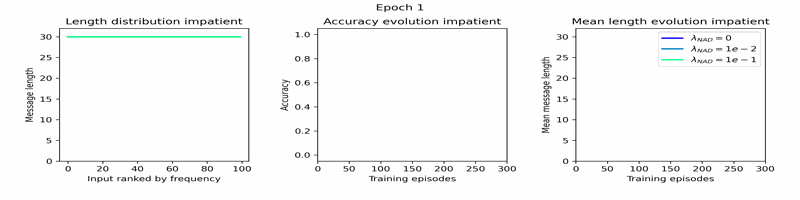

In [126]:
display_gif('impatient')

In [127]:
%%capture
create_gif_same_plot(EXPERIMENTS_NOT_IMPATIENT, nb_epochs=300, plot_every=1, save_dir='not_impatient')

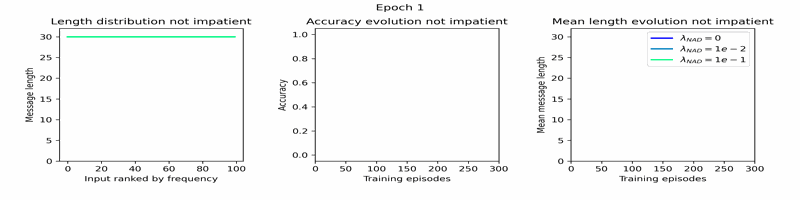

In [128]:
display_gif('not_impatient')

In [141]:
%%capture
!zip -r /content/fig.zip /content/fig